<a href="https://colab.research.google.com/github/joaocorreia01/PDS/blob/main/ProjetoPDS-Parte2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Disciplina: Processamento Digital de Sinais

## Professor: Dr. Thiago Damasceno Cordeiro

## Alunos:
* Arturo Jimenez Loaíza
* Gabriel Vitorino de Andra
* João Levi Gomes de Lima
* João Matheus Nascimento Dias
* João Victor Cavalcante da Silva Correia





# Projeto de Filtragem Digital de Áudio de Cavaquinho

## Bibliotecas utilizadas

In [ ]:
import numpy as np #manipulação numérica
from scipy.io import wavfile #ler o arquivo .wav
from scipy import signal #para funções de processamento de sinais (incluindo projeto de filtros e filtragem)
import matplotlib.pyplot as plt # plotar os gráficos
from IPython.display import Audio #tocar áudios no Colab

# Carregamento do Áudio (Taxa de amostragem do nosso sinal (), Normalização do sinal, Vetor tempo do sinal, mostrando sinal original)

##Introdução
Processamento inicial de um arquivo de áudio no formato WAV, especificamente uma gravação de solo de cavaquinho. O código realiza as seguintes operações:

* Carregamento do arquivo de áudio
* Verificação e ajuste para mono
* Normalização do sinal
* Cálculo de parâmetros temporais

## Metodologia

### Carregamento do Arquivo

O sinal é carregado usando a função `wavfile.read`:

$$
f_s, x[n] = \text{wavfile.read('solo\_cavaquinho.wav')}
$$

onde:

- $f_s $: taxa de amostragem (Hz)  
- $ x[n] $: sinal discreto (amostras)

### Pré-processamento

1. **Canal único**: Se estéreo, usa apenas o primeiro canal:

$$
x_{\text{mono}}[n] = x[n,0]
$$

2. **Normalização**: Ajusta a amplitude para o intervalo \([-1, 1]\):

$$
x_{\text{norm}}[n] = \frac{x[n]}{\max(|x|)}
$$

### Análise Temporal

- Duração calculada por:

$$
T = \frac{N}{f_s}
$$

- Vetor de tempo discreto:

$$
t[n] = n \cdot T_s \quad \text{com} \quad T_s = \frac{1}{f_s}
$$

In [ ]:
try:
    fs_original, sinal_original = wavfile.read('solo_cavaquinho.wav') #carregamos aqui o áudio do cavaquinho


    # A taxa de amostragem (f_s) é crucial. Ela define a quantidade de amostras por segundo do seu sinal. É
    # com base nela que você vai definir os parâmetros do seu filtro e verificar o critério de Nyquist.
    print(f"Taxa de amostragem original: {fs_original} Hz")

    # Se o áudio for estéreo, pegar apenas um canal
    if sinal_original.ndim > 1:
        sinal_original = sinal_original[:, 0]

    # Normalizar o sinal para o intervalo [-1, 1] (é comum fazer isso para processamento)
    sinal_original = sinal_original / np.max(np.abs(sinal_original))

    duracao_original = len(sinal_original) / fs_original
    print(f"Duração do sinal: {duracao_original:.2f} segundos")

    # Criar vetor de tempo para o sinal original
    tempo_original = np.linspace(0, duracao_original, len(sinal_original), endpoint=False)

except FileNotFoundError:
    print("Arquivo 'solo_cavaquinho.wav' não encontrado")


# Mostrar áudio original (se carregado)
if 'sinal_original' in locals():
    print("Áudio Original:")
    display(Audio(sinal_original, rate=fs_original))

Taxa de amostragem original: 44100 Hz
Duração do sinal: 48.07 segundos
Áudio Original:


# Análise de Sinal de Áudio no Domínio do Tempo e Frequência


Nesta etapa do processamento, observamos o sinal de áudio de cavaquinho nas representações temporal e espectral, incluindo:

- Visualização da forma de onda no domínio do tempo  
- Transformada de Fourier para análise espectral  
- Identificação da frequência fundamental

## Análise no Domínio do Tempo

A representação temporal de um sinal de áudio descreve como sua amplitude varia ao longo do tempo:

$$
x(t), \quad \text{para } t \in [0, T]
$$

Onde:

- $ x(t) $: sinal no domínio do tempo
- $ T $: duração total do sinal em segundos

A forma de onda é normalmente apresentada com amplitude normalizada
$$
x(t) \in [-1, 1] \:
$$

- Eixo horizontal: tempo (em segundos)  
- Eixo vertical: amplitude



## Análise no Domínio da Frequência

A análise espectral revela o conteúdo em frequência de um sinal, ou seja, quais componentes senoidais o compõem.

### Transformada de Fourier Discreta

É usada para converter o sinal do domínio do tempo para o domínio da frequência:

$$
X[k] = \sum_{n=0}^{N-1} x[n] \cdot e^{-j 2\pi kn/N}
$$

Onde:

- \( N \): número de amostras do sinal
- \( X[k] \): valor complexo da frequência \( k \)-ésima

### Magnitude e Frequência

A magnitude das componentes é normalizada por:

$$
|X_{\text{norm}}[k]| = \frac{|X[k]|}{N}
$$

As frequências associadas a cada \( k \) são:

$$
f_k = \frac{k \cdot f_s}{N}
$$

Sendo \( f_s \) a taxa de amostragem. A análise é geralmente limitada à metade do espectro (frequências positivas), até a frequência de Nyquist:

$$
f_{\text{Nyquist}} = \frac{f_s}{2}
$$


## Identificação da Frequência Fundamental

A frequência fundamental do sinal é aquela com maior energia espectral:

$$
f_{\text{max}} = \arg\max_k |X[k]|
$$

Ela representa o componente de frequência dominante do som, e é essencial para:

- Reconhecimento de notas musicais  
- Análise de timbre  
- Projeto de filtros digitais

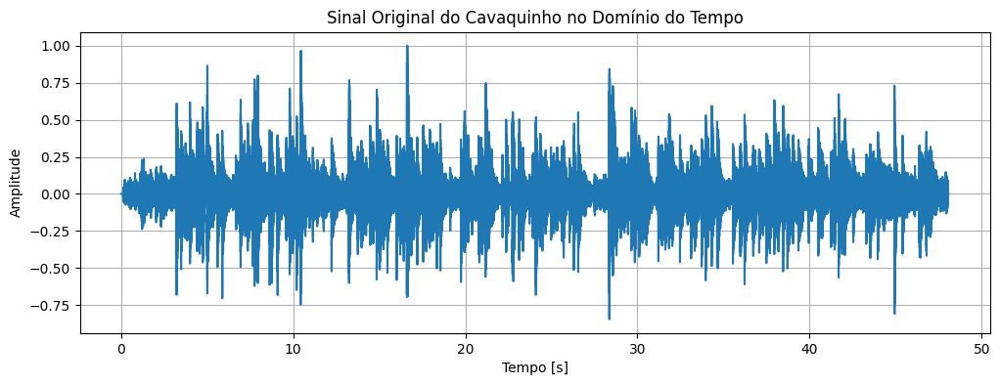

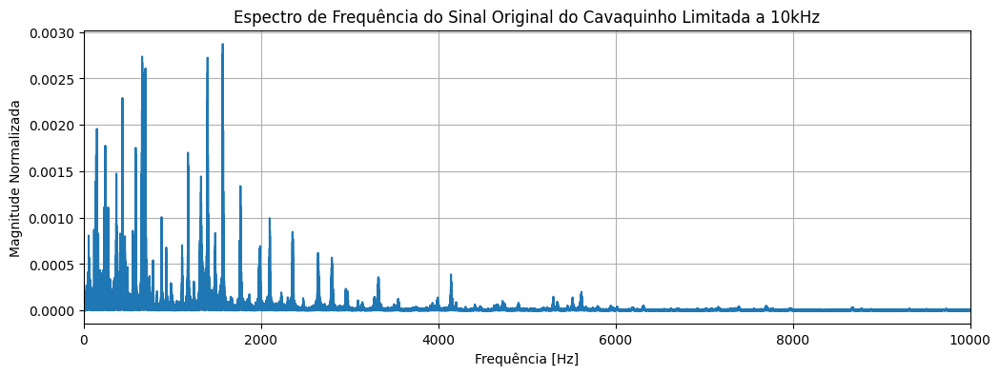

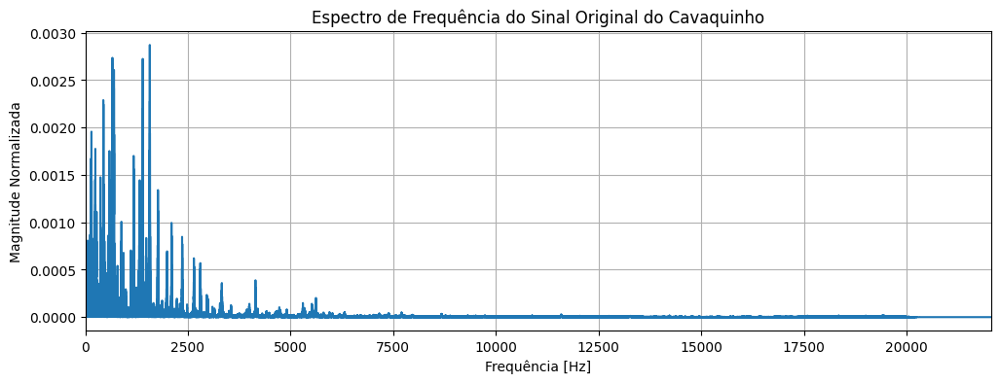

A frequência máxima do sinal é 1571.694972826087 Hz


In [ ]:
if 'sinal_original' in locals():
    # Análise no Domínio do Tempo
    plt.figure(figsize=(12, 4))
    plt.plot(tempo_original, sinal_original)
    plt.title('Sinal Original do Cavaquinho no Domínio do Tempo')
    plt.xlabel('Tempo [s]')
    plt.ylabel('Amplitude')
    plt.grid(True)
    plt.show()

    # Análise no Domínio da Frequência (FFT)
    N_original = len(sinal_original)
    fft_original = np.fft.fft(sinal_original)
    fft_freq_original = np.fft.fftfreq(N_original, d=1/fs_original)
    frequencies = np.fft.fftfreq(len(fft_original), d=1/fs_original)

    # Plotar apenas a parte positiva do espectro (até f_s/2)
    idx_positivas_original = np.where(fft_freq_original >= 0)
    fft_freq_plot_original = fft_freq_original[idx_positivas_original]
    fft_mag_plot_original = np.abs(fft_original[idx_positivas_original]) / N_original # Normalizar

    plt.figure(figsize=(12, 4))
    plt.plot(fft_freq_plot_original, fft_mag_plot_original)
    plt.title('Espectro de Frequência do Sinal Original do Cavaquinho Limitada a 10kHz')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Magnitude Normalizada')
    # plt.xlim(0, fs_original / 2) # Mostrar até a frequência de Nyquist
    plt.xlim(0, min(fs_original / 2, 10000)) # Limitar a um range útil para áudio, ex: 10 kHz
    plt.grid(True)
    plt.show()

    plt.figure(figsize=(12, 4))
    plt.plot(fft_freq_plot_original, fft_mag_plot_original)
    plt.title('Espectro de Frequência do Sinal Original do Cavaquinho')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Magnitude Normalizada')
    plt.xlim(0, fs_original / 2) # Mostrar até a frequência de Nyquist
    # plt.xlim(0, min(fs_original / 2, 10000)) # Limitar a um range útil para áudio, ex: 10 kHz
    plt.grid(True)
    plt.show()


    # Identifique a frequência máxima aproximada do seu sinal de cavaquinho
    max_freq = abs(frequencies[np.argmax(abs(fft_original))])
    print(f"A frequência máxima do sinal é {max_freq} Hz")
    # Esta informação será útil para projetar o filtro.

# Adição de Ruído ao Sinal

Esta etapa do trabalho analisa matematicamente o processo de adição de ruído a um sinal de áudio, abordando sua representação nos domínios temporal e espectral.

### Ruído Branco Gaussiano

O ruído branco é modelado como:

$$
r_{\text{branco}}[n] = A_{\text{ruido}} \cdot \mathcal{N}(0, 1)
$$

Onde:

- $A_{\text{ruido}} = 0{,}1$: amplitude do ruído  
- $\mathcal{N}(0, 1)$: distribuição normal de média 0 e variância 1

### Ruído Senoidal

Um tom senoidal é adicionado como ruído determinístico:

$$
r_{\text{senoidal}}[n] = A_{\text{sen}} \cdot \sin(2\pi f_{\text{sen}} t[n])
$$

Com:

- $A_{\text{sen}} = 0{,}15$: amplitude do tom  
- $f_{\text{sen}} = 5800 \, \text{Hz}$: frequência do ruído senoidal  
- $t[n] = n T_s$: vetor de tempo discreto

## Sinal Ruidoso

O sinal com ruído é formado pela soma linear:

$$
x_{\text{ruidoso}}[n] = x_{\text{original}}[n] + r_{\text{branco}}[n] + r_{\text{senoidal}}[n]
$$

### Clipping (Evitar Saturação)

Para manter o sinal dentro da faixa permitida \([-1, 1]\), aplica-se a função:

$$
x_{\text{ruidoso}}[n] = \text{clip}(x_{\text{ruidoso}}[n], -1, 1)
$$

A função `clip` é definida por:

$$
\text{clip}(x, a, b) =
\begin{cases}
a & \text{se } x \leq a \\
x & \text{se } a < x < b \\
b & \text{se } x \geq b
\end{cases}
$$

## Análise no Domínio da Frequência

A análise espectral é feita pela Transformada Rápida de Fourier (FFT):

$$
X_{\text{ruidoso}}[k] = \text{FFT}\{x_{\text{ruidoso}}[n]\}
$$

A magnitude é normalizada:

$$
|X_{\text{ruidoso, norm}}[k]| = \frac{|X_{\text{ruidoso}}[k]|}{N}
$$

A visualização no domínio da frequência é geralmente limitada até 10 kHz, com foco nas componentes mais relevantes para o áudio.


## Interpretação Matemática

- **Ruído branco**: eleva o piso espectral, dificultando a distinção entre harmônicos sutis  
- **Ruído senoidal**: aparece como um pico isolado no espectro, centrado em 5800 Hz  
- **Relação Sinal-Ruído (SNR)**:

A SNR quantifica a razão entre o sinal útil e o ruído:

$$
\text{SNR} = 10 \log_{10} \left( \frac{P_{\text{sinal}}}{P_{\text{ruido}}} \right)
$$

Onde $P_{\text{sinal}}$ e $P_{\text{ruido}}$ são as potências médias do sinal e do ruído, respectivamente.



Áudio com Ruído:


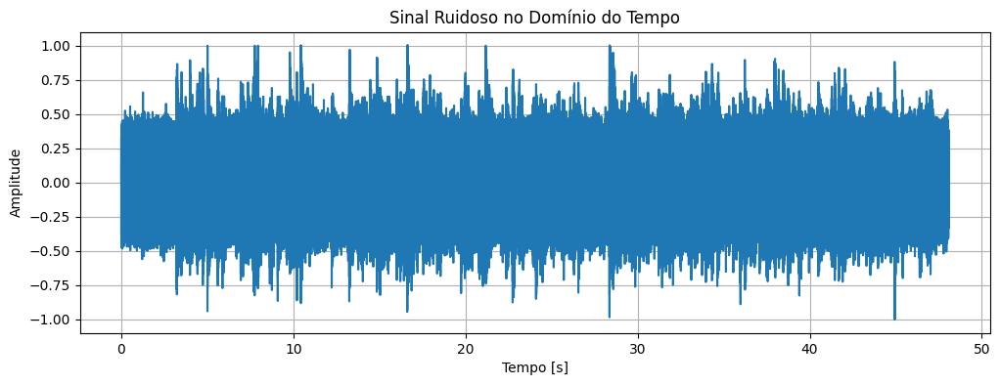

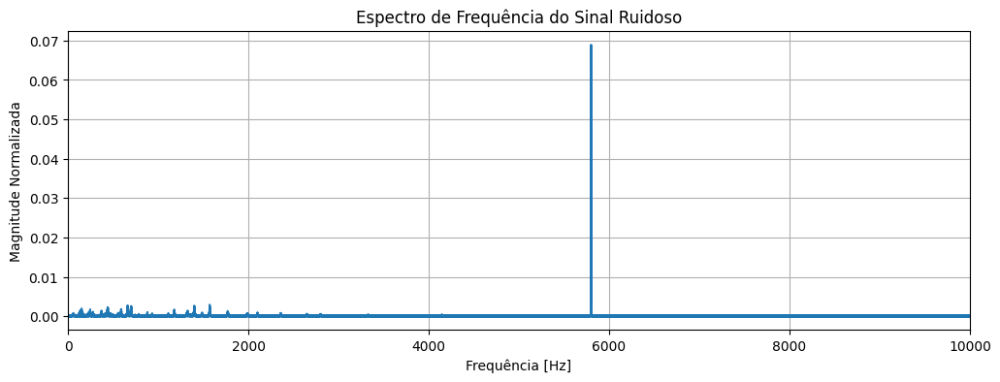

In [ ]:
if 'sinal_original' in locals():
    # Adicionar Ruído
    # Cenário: Ruído branco + um tom senoidal indesejado (ex: 2500 Hz)
    amplitude_ruido_branco = 0.1
    ruido_branco = amplitude_ruido_branco * np.random.normal(0, 1, len(sinal_original))

    # freq_senoidal_indesejada = 2500  # Hz (escolha uma frequência que seja visível e filtrável)
    freq_senoidal_indesejada = 5800  # Hz (escolha uma frequência que seja visível e filtrável)
    amplitude_senoidal_indesejada = 0.15
    ruido_senoidal = amplitude_senoidal_indesejada * np.sin(2 * np.pi * freq_senoidal_indesejada * tempo_original)

    sinal_ruidoso = sinal_original + ruido_branco + ruido_senoidal
    # Garantir que o sinal ruidoso não ultrapasse [-1, 1] (clipping simples)
    sinal_ruidoso = np.clip(sinal_ruidoso, -1, 1)

    print("\nÁudio com Ruído:")
    display(Audio(sinal_ruidoso, rate=fs_original))

    # Análise do Sinal Ruidoso no Domínio do Tempo
    plt.figure(figsize=(12, 4))
    plt.plot(tempo_original, sinal_ruidoso)
    plt.title('Sinal Ruidoso no Domínio do Tempo')
    plt.xlabel('Tempo [s]')
    plt.ylabel('Amplitude')
    plt.grid(True)
    plt.show()

    # Análise do Sinal Ruidoso no Domínio da Frequência (FFT)
    N_ruidoso = len(sinal_ruidoso)
    fft_ruidoso = np.fft.fft(sinal_ruidoso)
    fft_freq_ruidoso = np.fft.fftfreq(N_ruidoso, d=1/fs_original)

    idx_positivas_ruidoso = np.where(fft_freq_ruidoso >= 0)
    fft_freq_plot_ruidoso = fft_freq_ruidoso[idx_positivas_ruidoso]
    fft_mag_plot_ruidoso = np.abs(fft_ruidoso[idx_positivas_ruidoso]) / N_ruidoso

    plt.figure(figsize=(12, 4))
    plt.plot(fft_freq_plot_ruidoso, fft_mag_plot_ruidoso)
    plt.title('Espectro de Frequência do Sinal Ruidoso')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Magnitude Normalizada')
    # plt.xlim(0, fs_original / 2)
    plt.xlim(0, min(fs_original / 2, 10000))
    plt.grid(True)
    plt.show()

##  Projeto do Filtro Digital

Esta parte do trabalho trata o projeto teórico de um filtro digital FIR (Finite Impulse Response) passa-baixas aplicado ao processamento de sinais de áudio.


## Especificações do Filtro

### Parâmetros Fundamentais

- Frequência de corte: $f_c = 5000 \, \text{Hz}$  
- Taxa de amostragem: $f_s$  
- Frequência de Nyquist: $f_{Nyq} = \frac{f_s}{2}$  
- Frequência normalizada:  
  $$
  \omega_n = \frac{f_c}{f_{Nyq}} = \frac{2f_c}{f_s}
  $$


## Projeto do Filtro FIR

### Função de Transferência Discreta

Para um filtro FIR de ordem $N-1$, a função de transferência é:

$$
H(z) = \sum_{k=0}^{N-1} b_k z^{-k}
$$

onde $b_k$ são os coeficientes do filtro.

### Método de Projeto: Janela

A aproximação prática é feita via método da janela:

$$
b_k = h_d[k] \cdot w[k], \quad k = 0, \ldots, N-1
$$

- $h_d[k]$: resposta ao impulso ideal  
- $w[k]$: função janela (Hamming, neste caso)


## Janela de Hamming

A janela de Hamming usada na suavização dos coeficientes é definida como:

$$
w[n] = 0{,}54 - 0{,}46 \cos\left( \frac{2\pi n}{N-1} \right), \quad 0 \leq n \leq N-1
$$

Essa janela proporciona um bom equilíbrio entre largura do lóbulo principal e atenuação dos lóbulos laterais.


## Análise da Resposta em Frequência

A resposta em frequência do filtro FIR é obtida por:

$$
H(e^{j\omega}) = \sum_{n=0}^{N-1} b_n e^{-j\omega n}
$$

### Magnitude e Fase

- Magnitude em dB:
  $$
  20 \log_{10} \left| H(e^{j\omega}) \right|
  $$
- Fase:
  $$
  \angle~ H(e^{j\omega})
  $$


## Características do Projeto

| Parâmetro              | Valor         |
|------------------------|---------------|
| Número de coeficientes (\(N\)) | 101           |
| Frequência de corte (\(f_c\)) | 5000 Hz       |
| Tipo de janela         | Hamming       |
| Tipo de filtro         | Passa-baixas  |


## Justificativas de Projeto

### Escolha de Filtro FIR

- **Fase linear**: preserva a integridade temporal de sinais como áudio  
- **Estabilidade intrínseca**: todos os polos estão na origem (z = 0)

### Janela de Hamming

- Boa atenuação de lóbulos laterais
- Largura de transição razoável

### Frequência de Corte

- O espectro do instrumento (cavaquinho) está concentrado até ~5000 Hz  
- Ruído senoidal está em 5800 Hz → pode ser atenuado pelo filtro

### Ordem do Filtro (N)

- Controla a transição entre banda passante e banda de rejeição  
- Maior \( N \) melhora seletividade, mas aumenta custo computacional



Coeficientes do Filtro Passa-Baixas FIR (primeiros 10 de 101): [-0.0004 -0.0002  0.0002  0.0005  0.0006  0.0004 -0.0001 -0.0006 -0.001
 -0.0009]


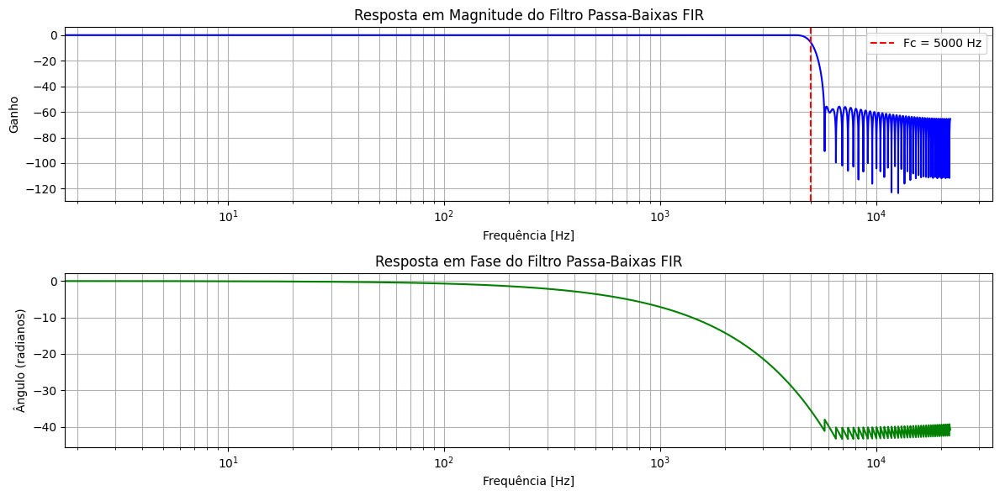

In [ ]:
if 'sinal_ruidoso' in locals():
    # ---- PROJETO DO FILTRO PASSA-BAIXAS (EXEMPLO FIR) ----

    # Especificações do Filtro Passa-Baixas
    # Frequência de corte - defina com base na análise do espectro do cavaquinho e do ruído.
    # Ex: Se o cavaquinho tem conteúdo importante até uns 3500 Hz e o tom indesejado está em 2500 Hz,
    # este filtro não removerá o tom. Um passa-baixas removeria AMBOS se o tom estivesse acima de fc.
    # VAMOS ASSUMIR que o tom indesejado está em, digamos, 6000 Hz, e o cavaquinho vai até 5000 Hz.
    # Neste caso, um LP faria sentido para ambos.
    # Se o tom está DENTRO da banda do cavaquinho, você precisaria de um NOTCH.

    # Ajuste fc_pb conforme sua análise!
    # fc_pb = 4000  # Hz (Frequência de corte do Passa-Baixas) ALTERADO
    fc_pb = 5000  # Hz (Frequência de corte do Passa-Baixas)
    nyquist_freq = fs_original / 2
    wn_pb = fc_pb / nyquist_freq # Frequência de corte normalizada

    # Número de coeficientes (taps) para o filtro FIR. Influencia a inclinação.
    # Um valor comum é um múltiplo ímpar da taxa de amostragem sobre a largura da banda de transição.
    # Ou, mais simples, comece com um valor e ajuste.
    num_taps_pb = 101 # Deve ser ímpar para ter atraso de grupo inteiro (para alguns tipos de simetria)

    # Projetar o filtro FIR Passa-Baixas usando janela de Hamming
    # A função firwin projeta o filtro e retorna os coeficientes b_k
    coef_b_pb = signal.firwin(num_taps_pb, wn_pb, window='hamming', pass_zero='lowpass')
    # A função de transferência H(z) para um filtro FIR é simplesmente o polinômio com esses coeficientes.
    # H(z) = coef_b_pb[0] + coef_b_pb[1]z^-1 + ... + coef_b_pb[num_taps_pb-1]z^-(num_taps_pb-1)

    print(f"\nCoeficientes do Filtro Passa-Baixas FIR (primeiros 10 de {len(coef_b_pb)}): {np.round(coef_b_pb[:10], 4)}")

    # Resposta em Frequência do Filtro Passa-Baixas
    w_pb, h_pb = signal.freqz(coef_b_pb, worN=8000) # Calcula a resposta em frequência

    #Ajuste para o diagrama de bode
    magnitude_db = 20 * np.log10(np.abs(h_pb))
    frequencia_hz = (w_pb / np.pi) * nyquist_freq

    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    #plt.plot((w_pb / np.pi) * nyquist_freq, np.abs(h_pb), 'b')
    plt.semilogx(frequencia_hz, magnitude_db, 'b')
    plt.title('Resposta em Magnitude do Filtro Passa-Baixas FIR')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Ganho')
    plt.axvline(fc_pb, color='red', linestyle='--', label=f'Fc = {fc_pb} Hz')
    plt.legend()
    plt.grid(True, which='both')

    plt.subplot(2, 1, 2)
    angles_pb = np.unwrap(np.angle(h_pb))
    #plt.plot((w_pb / np.pi) * nyquist_freq, angles_pb, 'g')
    plt.semilogx(frequencia_hz, angles_pb, 'g')
    plt.title('Resposta em Fase do Filtro Passa-Baixas FIR')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Ângulo (radianos)')
    plt.grid(True, which='both')
    plt.tight_layout()
    plt.show()

    # Explique:
    # - Por que FIR? (Fase linear é importante para áudio).
    # - Por que janela de Hamming? (Bom compromisso entre atenuação e transição).
    # - Como fc_pb foi escolhida? (Baseado no espectro do cavaquinho vs ruído).
    # - O que a ordem (num_taps_pb) influencia? (Inclinação da atenuação).
    # - A função de transferência H(z) (mencionar que é um polinômio em z^-1 com os coeficientes b).

Análise do projeto teórico de um filtro notch IIR (Infinite Impulse Response), projetado para remover seletivamente uma frequência específica de um sinal de áudio.

## Especificações do Filtro Notch

### Parâmetros Fundamentais

- Frequência central: $f_0 = f_{\text{ruído}} \, \text{Hz}$  
- Fator de qualidade: $Q = 30$  
- Largura de banda:  
  $$
  BW = \frac{f_0}{Q}
  $$
- Frequência normalizada:
  $$
  \omega_n = \frac{f_0}{f_{Nyq}} = \frac{2f_0}{f_s}
  $$


## Projeto do Filtro IIR

### Função de Transferência

A estrutura geral de um filtro notch de segunda ordem é dada por:

$$
H(z) = \frac{b_0 + b_1 z^{-1} + b_2 z^{-2}}{a_0 + a_1 z^{-1} + a_2 z^{-2}}
$$

- $ b_k $: coeficientes do numerador  
- $ a_k $: coeficientes do denominador  
- $ a_0 $ é geralmente normalizado para 1


## Fórmula do Filtro Notch (iirnotch)

O filtro projetado via `iirnotch` tem a forma:

$$
H(z) = \frac{1 - 2\cos(\theta)z^{-1} + z^{-2}}{1 - 2r\cos(\theta)z^{-1} + r^2 z^{-2}}
$$

- $ \theta = 2\pi \frac{f_0}{f_s} $  
- $ r \approx 1 - \frac{BW}{2} $  :  controla a largura do notch  


## Resposta em Frequência

A resposta em frequência é calculada como:

$$
H(e^{j\omega}) = \frac{\sum_{k=0}^2 b_k e^{-j\omega k}} {\sum_{k=0}^2 a_k e^{-j\omega k}}
$$

### Visualização

- Magnitude (dB):  
  $$
  20 \log_{10} \left| H(e^{j\omega}) \right|
  $$
- Fase:
  $$
  \angle H(e^{j\omega})
  $$


## Características do Projeto

| Parâmetro                 | Valor                          |
|---------------------------|--------------------------------|
| Ordem do filtro           | 2                              |
| Frequência central ($f_0$) | $f_{\text{ruído}}$ Hz |
| Fator de qualidade ($Q$)   | 30                             |
| Largura de banda ($BW$)    | $ f_0 / Q $ Hz               |


## Justificativas de Projeto

### Escolha do Filtro IIR

- Alta eficiência computacional  
- Ideal para notches estreitos com baixa ordem  
- Excelente para remover tons senoidais específicos

### Escolha do Fator de Qualidade \( Q \)

- $ Q = 30 $ → $ BW \approx \frac{5800}{30} \approx 193 \, \text{Hz} $  
- Compromisso entre:
  - Seletividade (eliminação eficaz)
  - Preservação de frequências próximas ao sinal desejado

### Fase e Atraso

- Fase não-linear é típica de filtros IIR  
- Menos relevante em remoção de ruído tonal  
- O atraso de grupo é variável com a frequência



Coeficientes do Filtro Notch IIR:
  b: [ 0.9864 -1.3367  0.9864]
  a: [ 1.     -1.3367  0.9728]


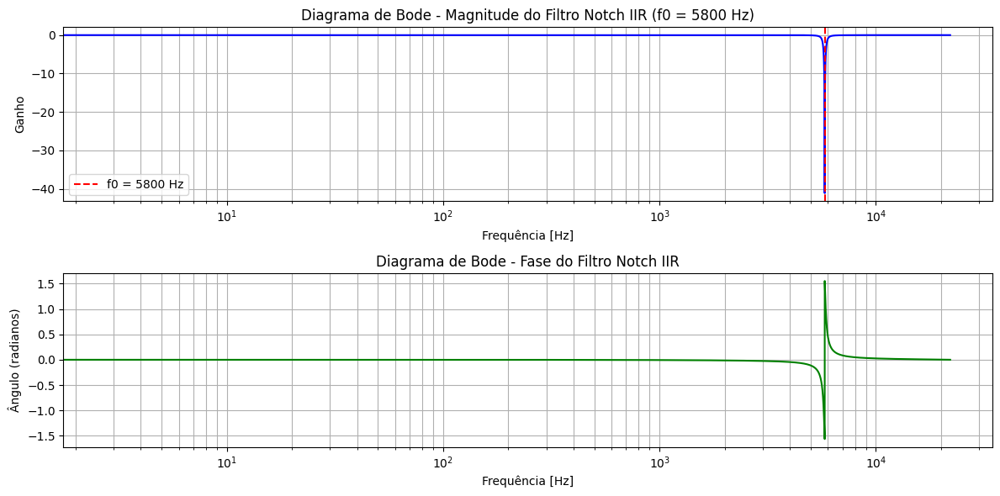

In [ ]:
if 'sinal_ruidoso' in locals() and 'freq_senoidal_indesejada' in globals():
    # ---- PROJETO DO FILTRO NOTCH (EXEMPLO IIR) ----
    # Para remover o tom senoidal em freq_senoidal_indesejada (ex: 2500 Hz)

    f0_notch = freq_senoidal_indesejada  # Frequência a ser rejeitada
    Q_notch = 30  # Fator de qualidade. Q = f0 / BW. BW = f0 / Q.
                  # Um Q maior significa um notch mais estreito.
    wn_notch = f0_notch / nyquist_freq # Frequência normalizada

    # Projetar o filtro IIR Notch (usando iirnotch)
    # A função iirnotch retorna os coeficientes b_k e a_k do filtro IIR
    # H(z) = (b0 + b1*z^-1 + b2*z^-2) / (a0 + a1*z^-1 + a2*z^-2)
    # Note que iirnotch geralmente retorna um filtro de segunda ordem (3 coefs para b e a)
    coef_b_notch, coef_a_notch = signal.iirnotch(wn_notch, Q_notch)

    print(f"\nCoeficientes do Filtro Notch IIR:")
    print(f"  b: {np.round(coef_b_notch, 4)}")
    print(f"  a: {np.round(coef_a_notch, 4)}") # a[0] é geralmente 1

    # Resposta em Frequência do Filtro Notch
    w_notch, h_notch = signal.freqz(coef_b_notch, coef_a_notch, worN=8000)

    # Converter resposta em dB
    magnitude_db_notch = 20 * np.log10(np.abs(h_notch))
    frequencia_hz_notch = (w_notch / np.pi) * nyquist_freq

    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    #plt.plot((w_notch / np.pi) * nyquist_freq, np.abs(h_notch), 'b')
    plt.semilogx(frequencia_hz_notch, magnitude_db_notch, 'b')
    plt.title(f'Diagrama de Bode - Magnitude do Filtro Notch IIR (f0 = {f0_notch} Hz)')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Ganho')
    plt.axvline(f0_notch, color='red', linestyle='--', label=f'f0 = {f0_notch} Hz')
    plt.legend()
    plt.grid(True, which='both')

    plt.subplot(2, 1, 2)
    angles_notch = np.unwrap(np.angle(h_notch))
    #plt.plot((w_notch / np.pi) * nyquist_freq, angles_notch, 'g')
    plt.semilogx(frequencia_hz_notch, angles_notch, 'g')
    plt.title('Diagrama de Bode - Fase do Filtro Notch IIR')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Ângulo (radianos)')
    plt.grid(True, which='both')
    plt.tight_layout()
    plt.show()

    # Explique:
    # - Por que IIR para o Notch? (Eficiente para notches agudos).
    # - Como f0_notch e Q_notch foram escolhidos?
    # - A função de transferência H(z) (mencionar que é uma razão de polinômios em z^-1).

# Aplicação do Filtro Digital (Filtragem)

plicação em cascata de filtros digitais (FIR passa-baixas e IIR notch) para processamento de sinais de áudio, com ênfase na técnica de filtragem de fase zero.

---

## Aplicação do Filtro FIR Passa-Baixas

### Método `filtfilt`

A filtragem é realizada com:

$$
y_{\text{pb}}[n] = \text{filtfilt}(\mathbf{b}_{\text{pb}}, [1.0], x_{\text{ruidoso}}[n])
$$

Onde:

- $\mathbf{b}_{\text{pb}}$: Coeficientes do filtro FIR passa-baixas  
- $[1.0]$: Denominador (monômio), pois FIR não tem pólos

---

### Características da Filtragem

- Fase linear (preserva forma de onda)
- Atraso de grupo nulo
- Processamento não causal (opera em todo o sinal)

---

## Aplicação do Filtro IIR Notch

### Método `filtfilt`

A filtragem é realizada com:

$$
y_{\text{notch}}[n] = \text{filtfilt}(\mathbf{b}_{\text{notch}}, \mathbf{a}_{\text{notch}}, x_{\text{entrada}}[n])
$$

Onde:

- $\mathbf{b}_{\text{notch}}, \mathbf{a}_{\text{notch}}$: Coeficientes do filtro IIR  
- $x_{\text{entrada}}[n]$: Pode ser o sinal ruidoso original ou já filtrado

---

### Compensação de Fase

- `filtfilt` aplica o filtro duas vezes (frente e verso), o que:
  - Compensa a fase não-linear
  - Dobra a ordem efetiva do filtro
  - Preserva a magnitude original

Resultado:

$$
|H_{\text{eff}}(e^{j\omega})| = |H(e^{j\omega})|^2
$$

$$
\angle H_{\text{eff}}(e^{j\omega}) = 0
$$

---

## Aplicação em Cascata

### Processamento Sequencial

O código implementa:

1. Aplicação independente de cada filtro
2. Aplicação sequencial (cascata):

$$
y_{\text{final}}[n] = \text{Notch}(\text{Passa-Baixas}(x_{\text{ruidoso}}[n]))
$$

---

### Função de Transferência Resultante

Para a cascata:

$$
H_{\text{total}}(z) = H_{\text{pb}}(z) \cdot H_{\text{notch}}(z)
$$

---

## Análise de Desempenho

| Parâmetro           | Efeito                             |
|---------------------|-------------------------------------|
| `filtfilt`          | Elimina distorção de fase           |
| Ordem do filtro     | Dobrada para IIR                    |
| Complexidade        | Aumenta com processamento reverso   |
| Armazenamento       | Requer todo o sinal na memória      |

---

## Considerações de Implementação

### Vantagens do `filtfilt`

- Compensação exata da fase não-linear
- Melhoria na resposta de magnitude:

$$
\text{Atenuação}_{\text{notch}} \rightarrow 2 \times \text{Atenuação}_{\text{original}}
$$

---

### Limitações

- Não aplicável a processamento em tempo real
- Requer processamento do sinal completo
- Aumento computacional (2 × operações)

---


In [ ]:
if 'sinal_ruidoso' in locals() and 'coef_b_pb' in locals():
    # Aplicar o Filtro Passa-Baixas FIR ao sinal ruidoso
    # Usar filtfilt para obter fase zero (recomendado para áudio quando não é em tempo real)
    sinal_filtrado_pb = signal.filtfilt(coef_b_pb, [1.0], sinal_ruidoso)
    # O [1.0] é o coeficiente 'a' para filtros FIR (denominador de H(z) é 1)

    print("\nÁudio Filtrado com Passa-Baixas FIR:")
    display(Audio(sinal_filtrado_pb, rate=fs_original))


# Exemplo de Código (Aplicando o Filtro Notch IIR com `filtfilt`):
# Se você também projetou o Notch:
if 'sinal_ruidoso' in locals() and 'coef_b_notch' in locals() and 'coef_a_notch' in locals():
    # Aplicar o Filtro Notch IIR ao sinal ruidoso (ou ao sinal já filtrado pelo PB)
    # Se for aplicar em sequência:
    # sinal_para_notch = sinal_filtrado_pb (se o PB foi aplicado primeiro)
    # OU
    sinal_para_notch = sinal_ruidoso # se for aplicar o notch diretamente no ruidoso

    sinal_filtrado_notch = signal.filtfilt(coef_b_notch, coef_a_notch, sinal_para_notch)

    print("\nÁudio Filtrado com Notch IIR:")
    display(Audio(sinal_filtrado_notch, rate=fs_original))

    # Se você aplicou os dois, o sinal final é o resultado da última filtragem.
    # Por exemplo, se aplicou PB e depois Notch:
    # sinal_filtrado_final = sinal_filtrado_notch
    # Se você só aplicou um, use esse como sinal_filtrado_final.
    # Para o restante da análise, vamos assumir que o sinal final é 'sinal_filtrado_pb'
    # ou 'sinal_filtrado_notch' se você usou esse.
    # Escolha qual resultado de filtragem você quer analisar:
    sinal_filtrado_final = sinal_filtrado_pb # Ou sinal_filtrado_notch


sinal_apos_todos_os_filtros = sinal_ruidoso
sinal_apos_todos_os_filtros = signal.filtfilt(coef_b_pb, [1.0], sinal_apos_todos_os_filtros)
sinal_apos_todos_os_filtros = signal.filtfilt(coef_b_notch, coef_a_notch, sinal_apos_todos_os_filtros)


print("Áudio Original:")
display(Audio(sinal_original, rate=fs_original))

print("\nÁudio com Ruído:")
display(Audio(sinal_ruidoso, rate=fs_original))

print("\nÁudio Filtrado com os 2 filtros:")
display(Audio(sinal_apos_todos_os_filtros, rate=fs_original))








Áudio Filtrado com Passa-Baixas FIR:



Áudio Filtrado com Notch IIR:


Áudio Original:



Áudio com Ruído:



Áudio Filtrado com os 2 filtros:


# Análise do Sinal Filtrado

Analise da comparação entre os sinais original, ruidoso e filtrado nos domínios do tempo e da frequência.

---

## Análise no Domínio do Tempo

### Seleção da Janela Temporal

O código analisa os primeiros 0.1 segundos do sinal:

$$
N_{\text{plot}} = \lfloor 0{,}1 \times f_s \rfloor
$$

onde $f_s$ é a taxa de amostragem.

---

### Representação Matemática

Para cada sinal na janela temporal:

$$
x_{\text{orig}}[n] : \text{Sinal original}
$$

$$
x_{\text{ruid}}[n] = x_{\text{orig}}[n] + r_b[n] + r_s[n]
$$

$$
x_{\text{filt}}[n] = \text{filtfilt}(x_{\text{ruid}}[n])
$$

---

### Métricas de Comparação

- Diferença de amplitude em pontos específicos  
- Preservação da forma de onda fundamental  
- Redução do ruído de alta frequência  

---

## Análise no Domínio da Frequência

### Cálculo da FFT

Para cada sinal:

$$
X[k] = \sum_{n=0}^{N-1} x[n] e^{-j2\pi kn/N}
$$

---

### Normalização

Magnitude normalizada:

$$
|X_{\text{norm}}[k]| = \frac{|X[k]|}{N}
$$

---

### Comparação Espectral

- Densidade espectral de potência (PSD) comparativa  
- Identificação de:
  - Componentes de frequência preservadas  
  - Bandas de frequência atenuadas  
  - Resíduos de ruído remanescentes  

---

## Visualização dos Resultados

### Parâmetros de Plotagem

| Parâmetro          | Valor                         |   |
|--------------------|-------------------------------|---|
| Janela temporal    | 0.1 s                         |   |
| Limite frequencial | min($\frac{f_s}{2}$, $10$ kHz)          |   |
| Normalização       | $\text{Magnitude}$ \over{N}$                 |   |

---

### Interpretação Gráfica

**Domínio do tempo**:
- Linha verde (filtrado) deve seguir a azul (original)
- Redução dos desvios da laranja (ruidoso)

**Domínio da frequência**:
- Atenuação nas bandas de rejeição dos filtros  
- Preservação do conteúdo espectral do sinal original  
- Remoção do pico em $f_{\text{ruido}}$  

---

## Métricas de Desempenho

### No Domínio do Tempo

Erro quadrático médio normalizado:

$$
\text{NMSE} = \frac{\sum_{n=0}^{N-1} |x_{\text{orig}}[n] - x_{\text{filt}}[n]|^2}{\sum_{n=0}^{N-1} |x_{\text{orig}}[n]|^2}
$$

---

### No Domínio da Frequência

Relação sinal-ruído na banda de interesse:

$$
\text{SNR}_{\text{banda}} = 10 \log_{10} \left( \frac{P_{\text{sinal}}}{P_{\text{ruido}}} \right)
$$

onde:

- $P_{\text{sinal}}$: Potência na banda do cavaquinho  
- $P_{\text{ruido}}$: Potência residual na banda rejeitada  

---


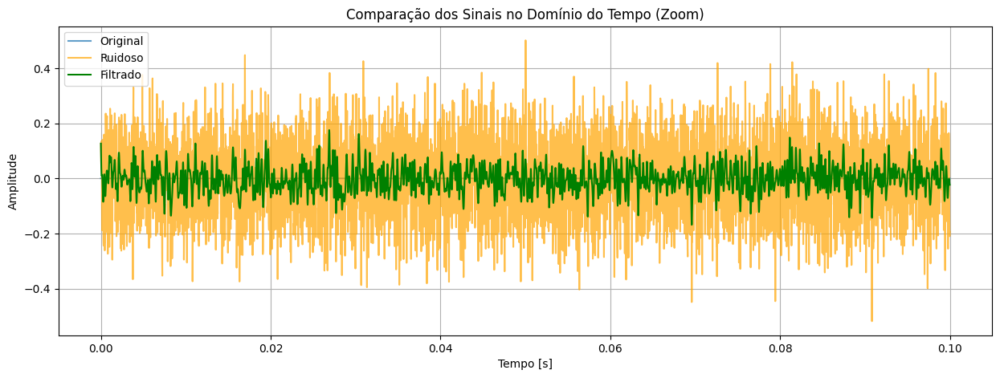

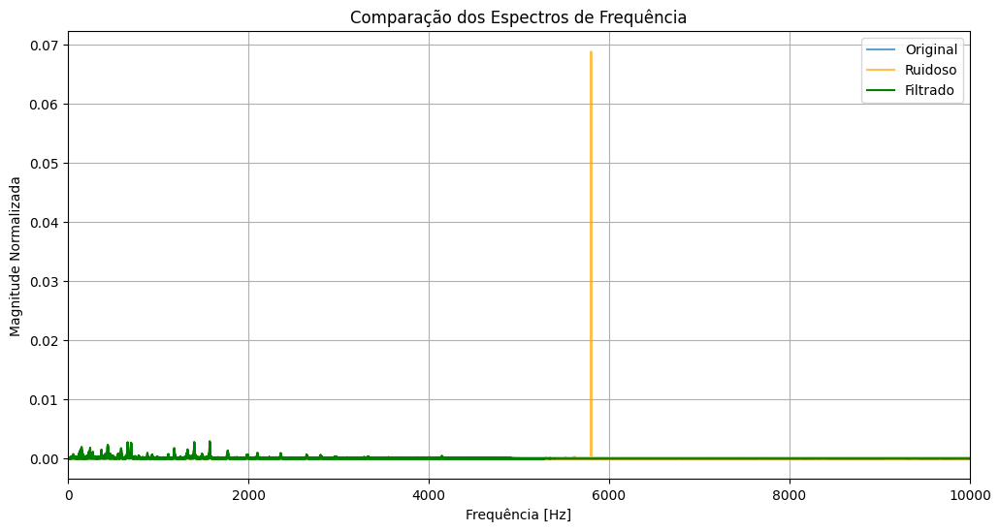

In [ ]:
if 'sinal_filtrado_final' in locals(): # Certifique-se que sinal_filtrado_final existe

    # Análise do Sinal Filtrado no Domínio do Tempo
    plt.figure(figsize=(15, 5)) # Aumentar um pouco a figura
    # Plotar original, ruidoso e filtrado juntos para comparação (uma pequena seção)
    # Encontrar um trecho interessante, por exemplo, os primeiros 0.1 segundos
    num_amostras_plot = int(0.1 * fs_original)

    plt.plot(tempo_original[:num_amostras_plot], sinal_original[:num_amostras_plot], label='Original', alpha=0.7)
    plt.plot(tempo_original[:num_amostras_plot], sinal_ruidoso[:num_amostras_plot], label='Ruidoso', alpha=0.7, color='orange')
    plt.plot(tempo_original[:num_amostras_plot], sinal_filtrado_final[:num_amostras_plot], label='Filtrado', color='green')
    plt.title('Comparação dos Sinais no Domínio do Tempo (Zoom)')
    plt.xlabel('Tempo [s]')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Análise do Sinal Filtrado no Domínio da Frequência (FFT)
    N_filtrado = len(sinal_filtrado_final)
    fft_filtrado = np.fft.fft(sinal_filtrado_final)
    fft_freq_filtrado = np.fft.fftfreq(N_filtrado, d=1/fs_original)

    idx_positivas_filtrado = np.where(fft_freq_filtrado >= 0)
    fft_freq_plot_filtrado = fft_freq_filtrado[idx_positivas_filtrado]
    fft_mag_plot_filtrado = np.abs(fft_filtrado[idx_positivas_filtrado]) / N_filtrado


    # Plotar espectros juntos para comparação
    plt.figure(figsize=(12, 6))
    plt.plot(fft_freq_plot_original, fft_mag_plot_original, label='Original', alpha=0.7)
    plt.plot(fft_freq_plot_ruidoso, fft_mag_plot_ruidoso, label='Ruidoso', alpha=0.7, color='orange')
    plt.plot(fft_freq_plot_filtrado, fft_mag_plot_filtrado, label='Filtrado', color='green')

    plt.title('Comparação dos Espectros de Frequência')
    plt.xlabel('Frequência [Hz]')
    plt.ylabel('Magnitude Normalizada')
    # plt.xlim(0, fs_original / 2)
    plt.xlim(0, min(fs_original / 2, 10000)) # Limitar a um range útil
    plt.legend()
    plt.grid(True)
    plt.show()